In [2]:
import os
import re
import sys
from pathlib import Path

import h5py
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import skimage
import squidpy as sq
from joblib import Parallel, delayed
from skimage import exposure, io
from tqdm.notebook import tqdm, trange

sc.settings.verbosity = 3

from functools import reduce

import anndata as ad
import scanorama
import seaborn as sns
from matplotlib import cm, colors
from matplotlib.pyplot import rc_context
from PIL import Image
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from statannotations.Annotator import Annotator

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)

module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)

In [5]:
import my_io as io
from config import *

In [6]:
data_ROI = data_dir / "ROI_new"

In [7]:
def get_masks(mask_folder):
    """
    Function to get all mask from mask forlder
    """
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition = name.split("_")[1][:2]
                masks[condition] = img
            else:
                continue
    return masks


def get_imgs(file_path, name):
    f = h5py.File(file_path, "r")
    imgs = f[name]
    labels = list(f[name].attrs["labels"])
    return imgs, labels

masks = get_masks(data_ROI / "masks")

In [8]:
datasets = list(masks.keys())

# Infiltration

In [9]:
adata_path = data_ROI / f"raw.h5ad"

In [10]:
if os.path.exists(adata_path):
    adata = ad.read_h5ad(adata_path)
else:
    print("Expression file not found")

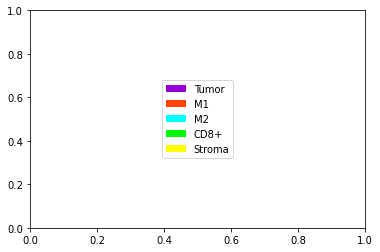

In [11]:
from matplotlib.colors import ListedColormap
from matplotlib.lines import Line2D
from matplotlib.patches import Patch

rgb = np.array([[148, 0, 211], [255, 69, 0], [0, 255, 255], [0, 255, 0], [255, 255, 0]])

legend_elements = [
    Patch(facecolor=rgb[0] / 255, label="Tumor"),
    Patch(facecolor=rgb[1] / 255, label="M1"),
    Patch(facecolor=rgb[2] / 255, label="M2"),
    Patch(facecolor=rgb[3] / 255, label="CD8+"),
    Patch(facecolor=rgb[4] / 255, label="Stroma"),
]

# Create the figure
fig, ax = plt.subplots()
ax.legend(handles=legend_elements, loc="center")

plt.show()

In [12]:
import matplotlib.font_manager as fm
import networkx as nx
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
from skimage import color, filters, measure
from sklearn.neighbors import NearestNeighbors


def get_distances(cell_mask, r=30):
    # NN classifier
    neigh = NearestNeighbors(radius=r)

    # Get centroid of cellmask
    prop = measure.regionprops_table(cell_mask, properties=["label", "centroid"])
    X = np.column_stack((prop["centroid-0"], prop["centroid-1"]))

    # fit the k-NN classifier
    neigh.fit(X)
    distances, neighbors = neigh.radius_neighbors(
        X, return_distance=True, sort_results=True
    )
    graph = neigh.radius_neighbors_graph(X, mode="distance").toarray()
    return distances, neighbors, prop["label"], graph, X


def connectpoints(x, y, p1, p2):
    x1, x2 = x[p1], x[p2]
    y1, y2 = y[p1], y[p2]
    plt.plot([x1, x2], [y1, y2], "b-", color="red", alpha=1, lw=1, zorder=0)


def plot_nn(X, graph, node_colors, ax):
    G = nx.from_numpy_array(graph)
    pos = dict(zip(np.arange(len(X)), X[:, [1, 0]]))
    nx.draw(
        G,
        pos,
        node_size=5,
        node_color=node_colors,
        edge_color="gray",
        linewidths=2,
        ax=ax,
    )


def get_cell_color(df, labels, rgb):

    label2num = dict(zip(labels, [i for i in range(len(labels))]))
    num2color = dict([(i, rgb[i] / 255) for i in range(len(labels))])

    cell_max_marker = df.idxmax(axis=1)
    cell_max_marker = cell_max_marker.apply(label2num.get)

    # index_low = (df < 0).all(axis=1)
    # cell_max_marker[index_low] = 4
    cell_max_color = cell_max_marker.apply(num2color.get)

    return cell_max_marker.to_dict(), cell_max_color.values


def replace_with_dict(ar, dic):
    dic[0] = np.nan

    # Extract out keys and values
    k = np.array(list(dic.keys()))
    v = np.array(list(dic.values()))

    # Get argsort indices
    sidx = k.argsort()

    ks = k[sidx]
    vs = v[sidx]
    return vs[np.searchsorted(ks, ar)]


def myround(x, base=5):
    return base * round(x / base)

In [13]:
from collections import defaultdict

from numpy.lib.stride_tricks import as_strided


def get_nei_info(cell_labels, neighbors, node_class, distances):
    node_nei_info = defaultdict(dict)
    for idx, node in enumerate(cell_labels):
        neighbor = neighbors[idx][1:]
        nei_class = np.array([node_class[cell_labels[n]] for n in neighbor])
        nei_distance = distances[idx][
            1:
        ]  # First distance always correspond to 0 for item itself

        unique, counts = np.unique(nei_class, return_counts=True)
        for idx, c in enumerate(unique):
            node_nei_info[node][c] = {
                "count": counts[idx],
                "avg_distance": np.mean(nei_distance[np.where(nei_class == c)]),
            }
    return node_nei_info


def get_node_patch(X, node_class, n):
    nodes = node_class.keys()
    patches = X // n
    return dict(zip(nodes, patches))


def tile_array(a, b0, b1):
    r, c = a.shape  # number of rows/columns
    rs, cs = a.strides  # row/column strides
    x = as_strided(a, (r, b0, c, b1), (rs, 0, cs, 0))  # view a as larger 4D array
    return x.reshape(r * b0, c * b1)  # create new 2D array


def patch_count(c, node_class, node_patch, n, shape):
    matching_node = [k for k, v in node_class.items() if v == c]
    patch_matrix = np.zeros(tuple(d // n for d in shape))
    for node in matching_node:
        i, j = node_patch[node]
        i = int(i)
        j = int(j)
        patch_matrix[i][j] += 1
    patch_matrix = patch_matrix
    return patch_matrix


def patch_count_neighbor(c1, c2, neighbor_class, node_class, node_patch, n, shape):
    patch_matrix = np.zeros(tuple(d // n for d in shape))
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            i, j = node_patch[node]
            i = int(i)
            j = int(j)
            patch_matrix[i][j] += neighbors.get(c2)["count"]
    patch_matrix = patch_matrix
    return patch_matrix


def count_neighbor(c1, c2, neighbor_class, node_class):
    count = 0
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            count += neighbors.get(c2)["count"]
    return count


def plot_count_patch(node_class, node_patch, n, shape, path=None):
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count(c, node_class, node_patch, n, shape))

    fig, axs = plt.subplots(2, 2, figsize=(12, 10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix), vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis("off")
        im = ax.imshow(patch_matrix[c], cmap="RdYlBu_r", norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label("Count")
    if path:
        fig.savefig(path, bbox_inches="tight")


def plot_interaction_patch(init_c, node_class, node_patch, n, shape, cmap, path=None):
    init_c = 0
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(
            patch_count_neighbor(init_c, c, neighbor_class, node_patch, n, shape)
        )

    fig, axs = plt.subplots(2, 2, figsize=(12, 10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix), vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis("off")
        im = ax.imshow(patch_matrix[c], cmap=cmap, norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label("Count")
    if path:
        fig.savefig(path, bbox_inches="tight")

In [14]:
h5_data = data_ROI / f"TMA.hdf5"

marker_subset = [
    "CD68",
    "Pankeratin",
    "E-cadherin",
    "CD8",
    "COL1",
    "SMA",
]

adata_macro = adata[:, marker_subset]
df = pd.DataFrame(adata_macro.X, columns=adata_macro.var_names)
df["Cell"] = adata_macro.obs["Cell"].to_list()
df["ROI"] = adata_macro.obs["ROI"].to_list()

C:\Users\thu71\AppData\Local\Temp/ipykernel_17632/139158692.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(15, 15))


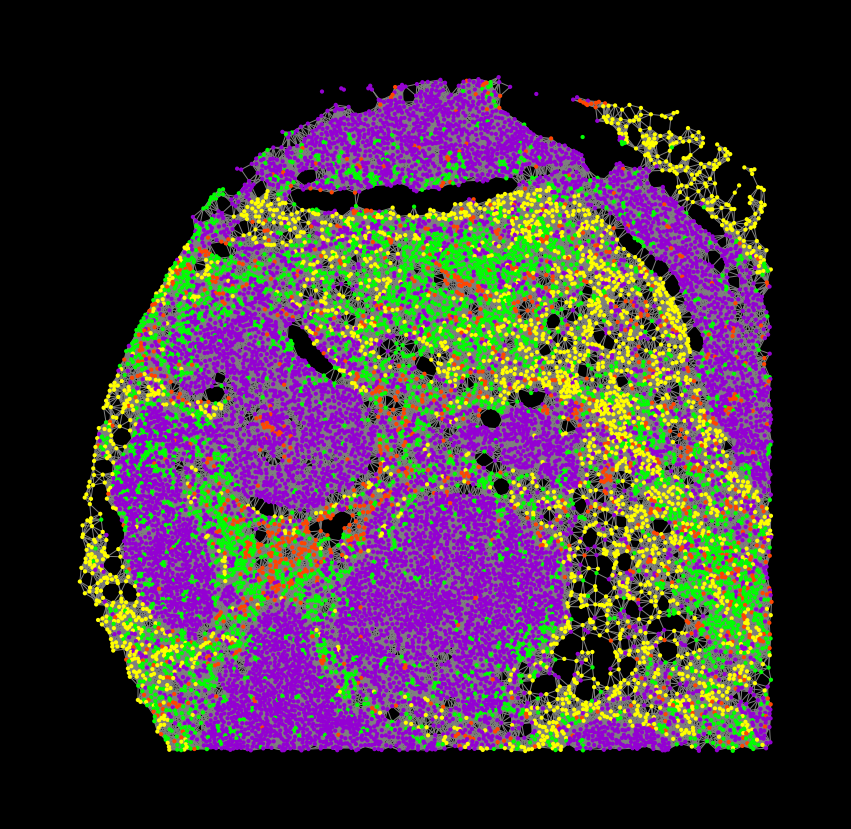

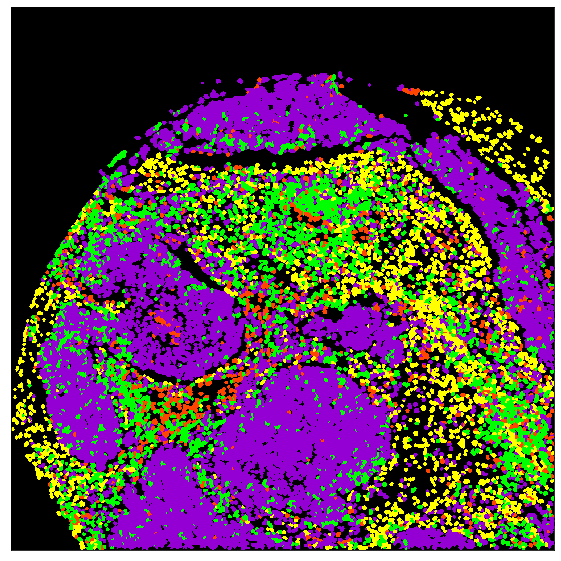

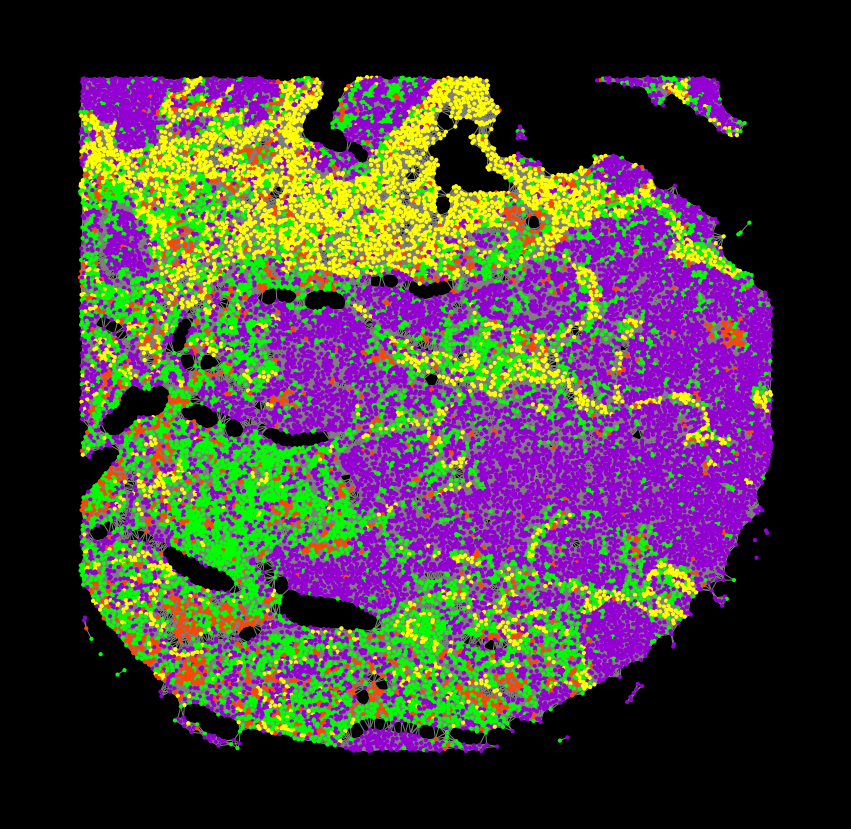

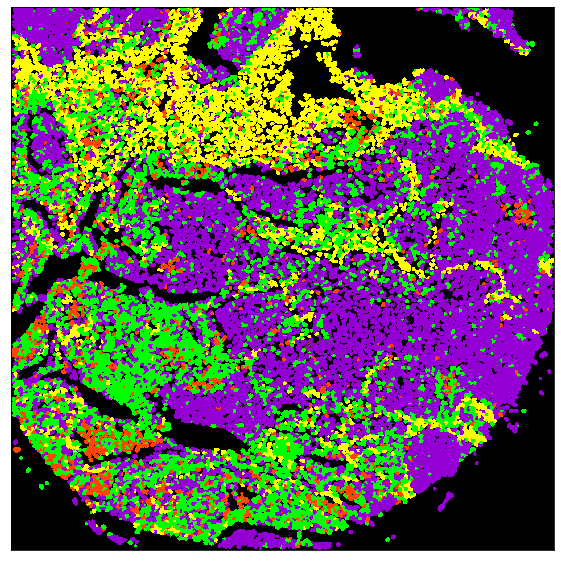

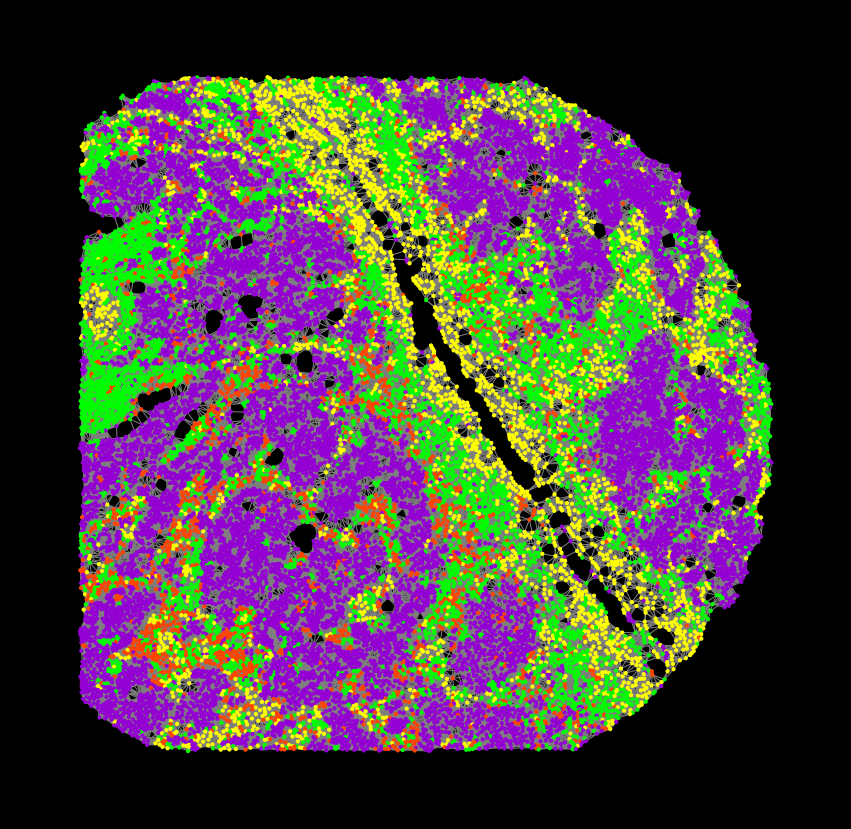

...

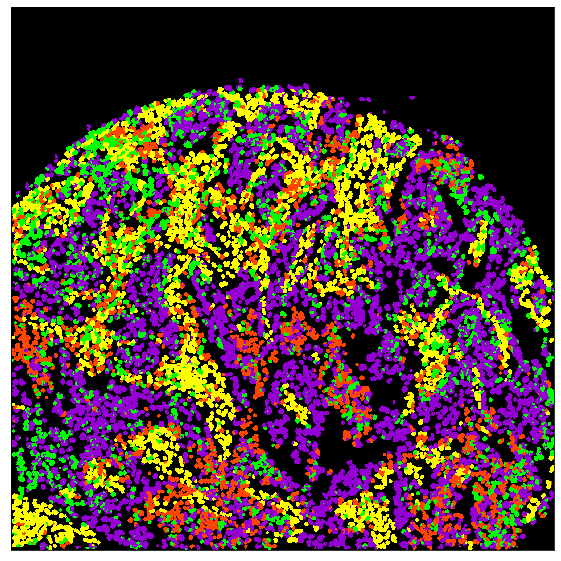

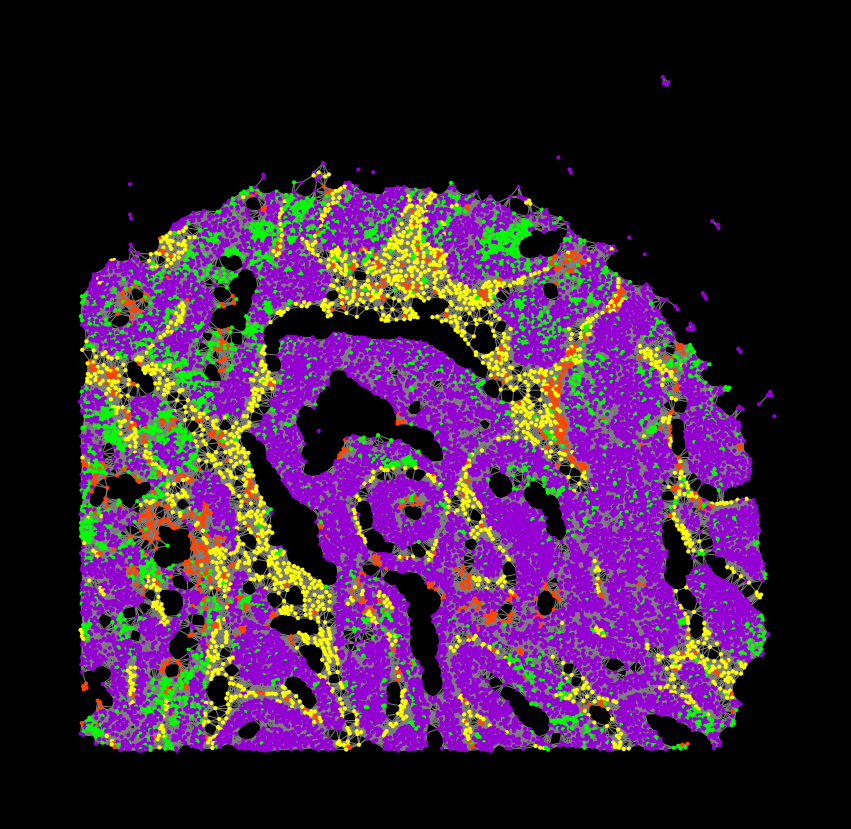

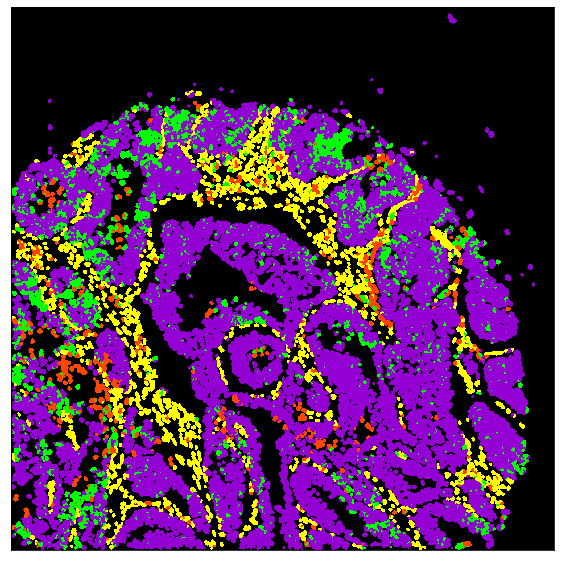

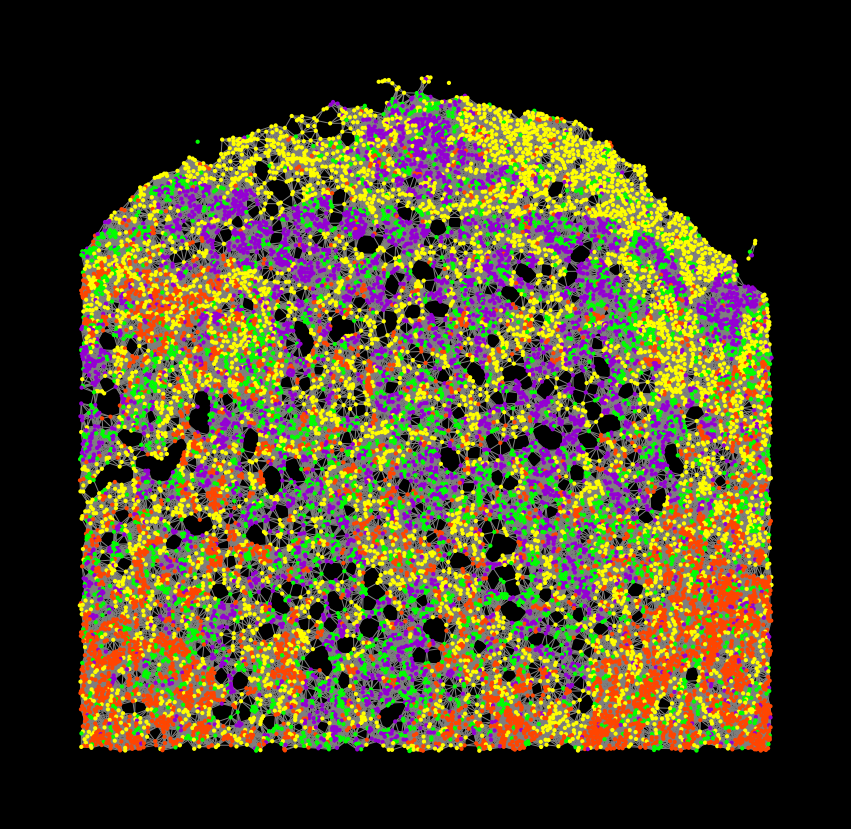

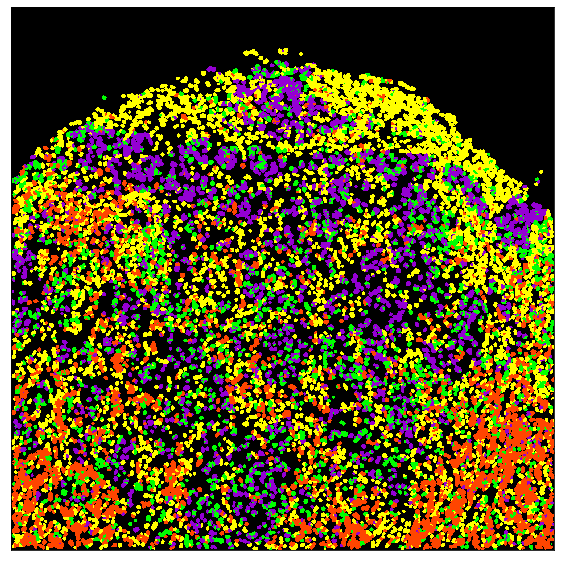

In [15]:
n = 25
group = df.groupby("ROI")
labels = ["ECA+PanK", "CD68", "CD8", "Col1+SMA"]
rgb = np.array([[148, 0, 211], [255, 69, 0],  [0, 255, 0], [255, 255, 0]])
mycmap = ListedColormap(rgb / 255)
fontprops = fm.FontProperties(size=34)
scores = defaultdict(list)
scores_count = defaultdict(list)
scores_all = defaultdict(list)
density = defaultdict(list)

for name, df_subset in group:
    imgs, _ = get_imgs(h5_data, name)

    # Get mask
    cell_mask = masks[name]
    min_shape = min(cell_mask.shape[0], cell_mask.shape[1])
    min_shape = myround(min_shape, base=n)
    cell_mask = cell_mask[:min_shape, :min_shape]
    avg_img = np.array(np.mean(imgs, axis=(0)))[:min_shape, :min_shape]

    # Get group intensity
    df_subset["ECA+PanK"] = df_subset[["Pankeratin", "E-cadherin"]].max(axis=1)
    df_subset["Col1+SMA"] = df_subset[["COL1", "SMA"]].max(axis=1)
    df_subset.set_index("Cell", inplace=True)
    df_subset = df_subset[labels]

    # Get cell neighbors analysis
    distances, neighbors, cell_labels, graph, X = get_distances(cell_mask)
    node_class, node_colors = get_cell_color(df_subset, labels, rgb)
    node_class, _ = get_cell_color(df_subset, labels, rgb)
    neighbor_class = get_nei_info(cell_labels, neighbors, node_class, distances)
    node_patch = get_node_patch(X, node_class, n)

    # Plot proximity map
    fig, ax = plt.subplots(figsize=(15, 15))
    ax.axis("off")
    plot_nn(X, graph, node_colors, ax)
    ax.invert_yaxis()
    ax.set_facecolor("black")
    fig.patch.set_facecolor("black")

    # Plot cell mask
    img = replace_with_dict(cell_mask, node_class)
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(img, cmap=mycmap, interpolation="None", vmin=0, vmax=4)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor("black")
    
    unique, counts = np.unique(img[~np.isnan(img)], return_counts=True)
    scale = (imgs[0].shape[0] * imgs[1].shape[1])/1000000
    density['Tumor'].append(counts[0]/scale)
    density['Stroma'].append(counts[3]/scale)
    density['CD8+'].append(counts[2]/scale)
    density['CD68+'].append(counts[1]/scale)

    # Get tumor and Stroma island
    tumor = patch_count(0, node_class, node_patch, n, avg_img.shape)
    m1 = patch_count(1, node_class, node_patch, n, avg_img.shape)
    ip = patch_count(2, node_class, node_patch, n, avg_img.shape)
    stroma = patch_count(3, node_class, node_patch, n, avg_img.shape)

    total = [patch_count(i, node_class, node_patch, n, avg_img.shape) for i in range(4)]
    total = np.sum(total, axis=(0))
    P_tumor = np.divide(tumor, total, out=np.zeros_like(total), where=total != 0)
    P_m1 = np.divide(m1, total, out=np.zeros_like(total), where=total != 0)
    P_ip = np.divide(ip, total, out=np.zeros_like(total), where=total != 0)
    P_stroma = np.divide(stroma, total, out=np.zeros_like(total), where=total != 0)

    m1_s = patch_count_neighbor(1, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    m1_t = patch_count_neighbor(1, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    m1_cd8 = patch_count_neighbor(1, 2, neighbor_class, node_class, node_patch, n, avg_img.shape)
    m1_total = [patch_count_neighbor(1, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    m1_total = np.sum(m1_total, axis=(0))
    P_m1_t = np.divide(m1_t, m1_total, out=np.zeros_like(m1_total), where=m1_total!=0)
    P_m1_s = np.divide(m1_s, m1_total, out=np.zeros_like(m1_total), where=m1_total!=0)
    P_m1_cd8 = np.divide(m1_cd8, m1_total, out=np.zeros_like(m1_total), where=m1_total!=0)
    

    ip_s_int = patch_count_neighbor(2, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_t_int = patch_count_neighbor(2, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_m1_int = patch_count_neighbor(2, 1, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_int_total = [patch_count_neighbor(2, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    ip_int_total = np.sum(ip_int_total, axis=(0))
    P_ip_t = np.divide(ip_t_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_s = np.divide(ip_s_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_m1 = np.divide(ip_m1_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)

    scores['CD68-T'].append(round(np.mean(P_m1_t),4))
    scores['CD68-S'].append(round(np.mean(P_m1_s),4))
    scores['CD68-CD8'].append(round(np.mean(P_m1_cd8),4))
    scores['CD8-T'].append(round(np.mean(P_ip_t),4))
    scores['CD8-S'].append(round(np.mean(P_ip_s),4))
    scores['CD8-CD68'].append(round(np.mean(P_ip_m1),4))

In [16]:
datasets_new = list(group.groups.keys())

In [17]:
df_new = pd.DataFrame(scores, index=datasets_new)
df_new

,CD68-T,CD68-S,CD68-CD8,CD8-T,CD8-S,CD8-CD68
B7,0.0764,0.0393,0.0583,0.1844,0.0705,0.0361
C3,0.0806,0.0439,0.0863,0.2484,0.0954,0.0495
D1,0.1029,0.0380,0.0936,0.1527,0.0901,0.0570
D2,0.0501,0.0623,0.0563,0.1898,0.1259,0.0444
D5,0.1425,0.0238,0.0214,0.2699,0.0320,0.0232
D9,0.1434,0.1298,0.0572,0.2064,0.1358,0.0427
F7,0.0606,0.0308,0.0512,0.1689,0.0789,0.0356
G3,0.0531,0.0693,0.0621,0.1981,0.1231,0.0397
H1,0.0842,0.0127,0.0147,0.1465,0.0189,0.0097
H2,0.0993,0.0679,0.0574,0.1777,0.0690,0.0620


In [18]:
density_ch1 = density

# Old Data

In [19]:
from skimage.filters.rank import median
from skimage.morphology import disk, ball
from config import *

In [20]:
df_metadata = pd.read_csv(data_dir / 'metadata.csv')
df_metadata.head()

,Pos,Grades,Stage,Directory
0,B1,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI001_B1
1,B3,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI005_B3
2,B5,2,II,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI006_B5
3,C6,AT,AT,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI007_C6
4,D7,3,IIIA,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI008_D7


In [21]:
datasets = df_metadata.Directory.to_list()
datasets = [name.split('\\')[-1] for name in datasets]

In [22]:
print(datasets)

['ROI001_B1', 'ROI005_B3', 'ROI006_B5', 'ROI007_C6', 'ROI008_D7', 'ROI009_D9', 'ROI012_E1', 'ROI015_B6', 'ROI016_F3', 'ROI017_F2', 'ROI018_G1', 'ROI019_G5', 'ROI020_E5', 'ROI021_E7']


In [23]:
import networkx as nx

def read_cell_mask(ROI: str):
    """Read all image from one ROI"""
    dir_ = data_figure / 'mask_DL'

    # Get images in directory
    dirpath, _, filenames = next(os.walk(dir_))
    for name in filenames:
        if 'both' in name:
            continue
        elif ROI in name and 'cyto' in name:
            mask_name = name
    mask = skimage.io.imread(os.path.join(dirpath, mask_name))
    return mask

def get_cell_expression_level_mean(imgs_list, labels, cell_mask):
    # Multiple each cell region by mean intensity 
    df_list = []
    for idx, img in enumerate(imgs_list):
        exp_prop = pd.DataFrame(measure.regionprops_table(cell_mask, img, properties=['label','mean_intensity'])).set_index('label')

        df = exp_prop.rename(columns = {'mean_intensity': labels[idx]}, errors = 'raise')
        df_list.append(df)
    df_exp = pd.concat(df_list, axis=1)
    return df_exp

def get_distances(cell_mask, r=30):
    # NN classifier
    neigh = NearestNeighbors(radius=r)
    
    # Get centroid of cellmask
    prop = measure.regionprops_table(cell_mask, properties=['label',"centroid"])
    X = np.column_stack((prop["centroid-0"], prop["centroid-1"]))
    
    # fit the k-NN classifier
    neigh.fit(X)
    distances, neighbors = neigh.radius_neighbors(X, return_distance=True, sort_results=True)
    graph = neigh.radius_neighbors_graph(X, mode='distance').toarray()
    return distances, neighbors, prop['label'], graph, X

def connectpoints(x,y,p1,p2):
    x1, x2 = x[p1], x[p2]
    y1, y2 = y[p1], y[p2]
    plt.plot([x1,x2],[y1,y2],"b-", color='red', alpha=1, lw=1, zorder=0)

def plot_nn(X, graph, node_colors, ax):
    G = nx.from_numpy_array(graph)
    pos = dict(zip(np.arange(len(X)), X[:,[1,0]]))
    nx.draw(G, pos, node_size=30, node_color=node_colors, edge_color='sandybrown', linewidths=2, ax=ax)
    
def get_cell_color(df, labels, rgb):

    label2num = dict(zip(labels, [i for i in range(len(labels))]))
    num2color = dict([(i, rgb[i]/255) for i in range(len(labels)+1)])
    
    cell_max_marker = df.idxmax(axis=1)
    cell_max_marker = cell_max_marker.apply(label2num.get)
    
    
    index_low = (df < 0).all(axis=1)
    cell_max_marker[index_low] = 4
    cell_max_color = cell_max_marker.apply(num2color.get)
    
    return cell_max_marker.to_dict(), cell_max_color.values

def replace_with_dict(ar, dic):
    dic[0] = np.nan
    
    # Extract out keys and values
    k = np.array(list(dic.keys()))
    v = np.array(list(dic.values()))

    # Get argsort indices
    sidx = k.argsort()

    ks = k[sidx]
    vs = v[sidx]
    return vs[np.searchsorted(ks,ar)]

def myround(x, base=5):
    return base * round(x/base)

In [24]:
from collections import defaultdict
from numpy.lib.stride_tricks import as_strided

def get_nei_info(cell_labels, neighbors, node_class, distances):
    node_nei_info = defaultdict(dict)
    for idx, node in enumerate(cell_labels):
        neighbor = neighbors[idx][1:]
        nei_class = np.array([node_class[cell_labels[n]] for n in neighbor])
        nei_distance = distances[idx][1:]   # First distance always correspond to 0 for item itself

        unique, counts = np.unique(nei_class, return_counts=True)
        for idx, c in enumerate(unique):
            node_nei_info[node][c] = {
                'count': counts[idx], 
                'avg_distance': np.mean(nei_distance[np.where(nei_class == c)])
            }
    return node_nei_info
                             
def get_node_patch(X, node_class, n):
    nodes = node_class.keys()
    patches = X//n
    return dict(zip(nodes, patches))

def tile_array(a, b0, b1):
    r, c = a.shape                                    # number of rows/columns
    rs, cs = a.strides                                # row/column strides 
    x = as_strided(a, (r, b0, c, b1), (rs, 0, cs, 0)) # view a as larger 4D array
    return x.reshape(r*b0, c*b1)                      # create new 2D array

def patch_count(c, node_class, node_patch, n, shape):
    matching_node = [k for k, v in node_class.items() if v == c]
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node in matching_node:
        i, j = node_patch[node]
        i = int(i)
        j = int(j)
        patch_matrix[i][j] += 1
    patch_matrix = patch_matrix
    return patch_matrix

def patch_count_neighbor(c1, c2, neighbor_class, node_class, node_patch, n, shape):
    patch_matrix = np.zeros(tuple(d//n for d in shape))
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            i, j = node_patch[node]
            i = int(i)
            j = int(j)
            patch_matrix[i][j] += neighbors.get(c2)['count']
    patch_matrix = patch_matrix
    return patch_matrix

def count_neighbor(c1, c2, neighbor_class, node_class):
    count = 0
    for node, neighbors in neighbor_class.items():
        if neighbors.get(c2) and node_class[node] == c1:
            count += neighbors.get(c2)['count']
    return count

def plot_count_patch(node_class, node_patch, n, shape, path=None):
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count(c, node_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = 'RdYlBu_r', norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')
    
def plot_interaction_patch(init_c, node_class, node_patch, n, shape, cmap, path=None):
    init_c = 0
    patch_matrix = []
    for c in range(4):
        patch_matrix.append(patch_count_neighbor(init_c, c, neighbor_class, node_patch, n, shape))

    fig, axs = plt.subplots(2,2, figsize = (12,10))
    ax = axs.flatten()
    norm = plt.Normalize(vmin=np.min(patch_matrix),
                         vmax=np.max(patch_matrix))
    for c, ax in enumerate(ax):
        ax.axis('off')
        im = ax.imshow(patch_matrix[c], cmap = cmap, norm=norm)
        ax.title.set_text(labels[c])
    fig.subplots_adjust(hspace=0.1, wspace=0.01)
    cbar = fig.colorbar(im, ax=axs, shrink=0.5)
    cbar.set_label('Count')
    if path:
         fig.savefig(path, bbox_inches='tight')

C:\Users\thu71\AppData\Local\Temp/ipykernel_17632/1267835667.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(15,15))


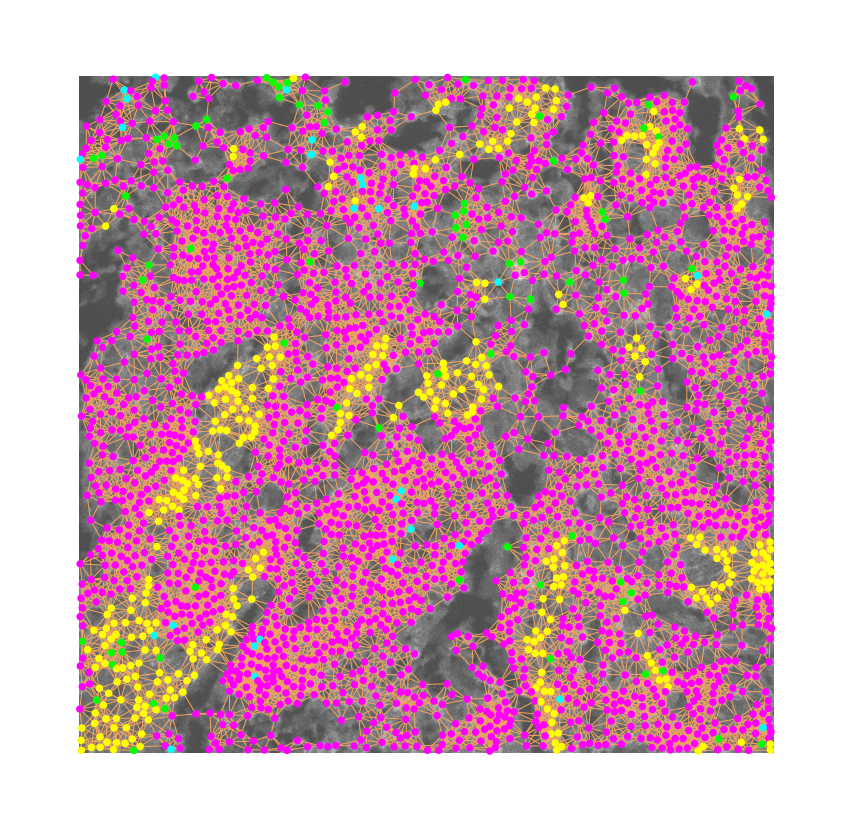

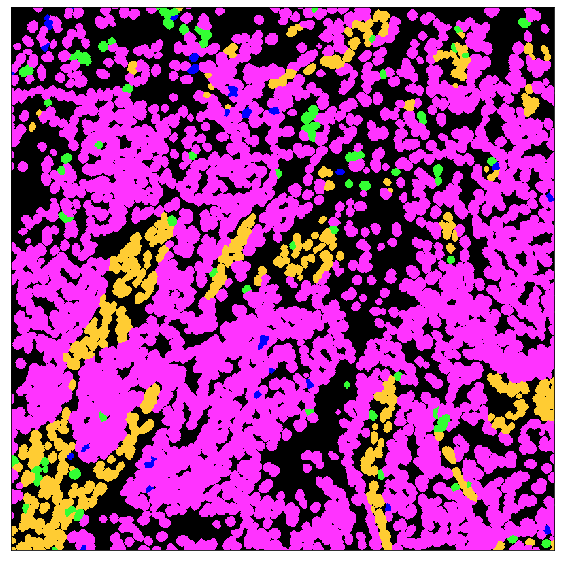

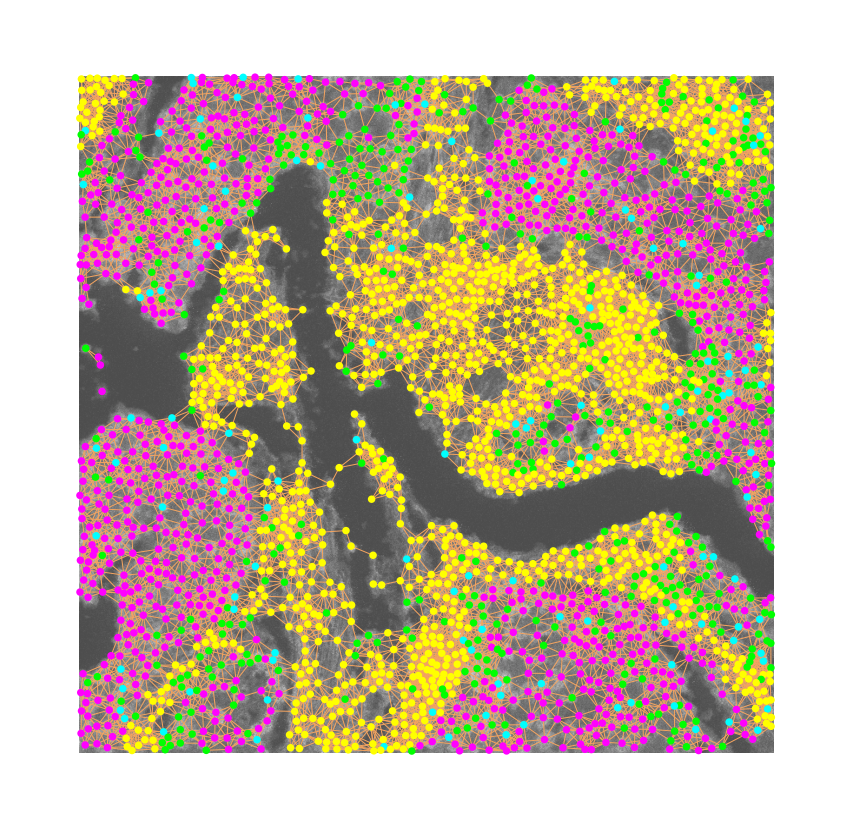

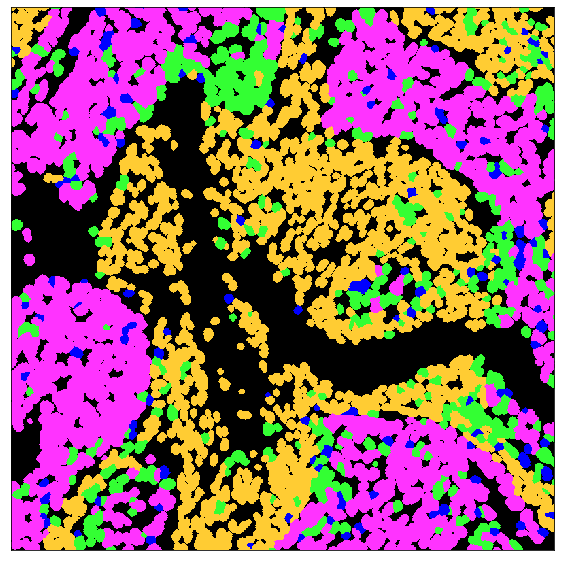

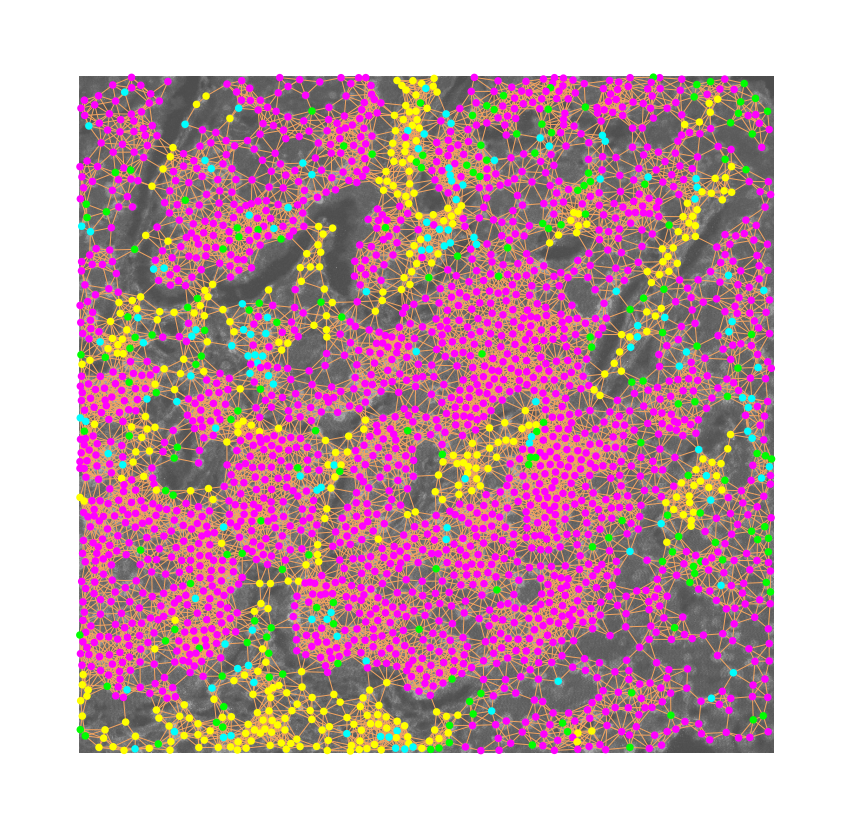

...

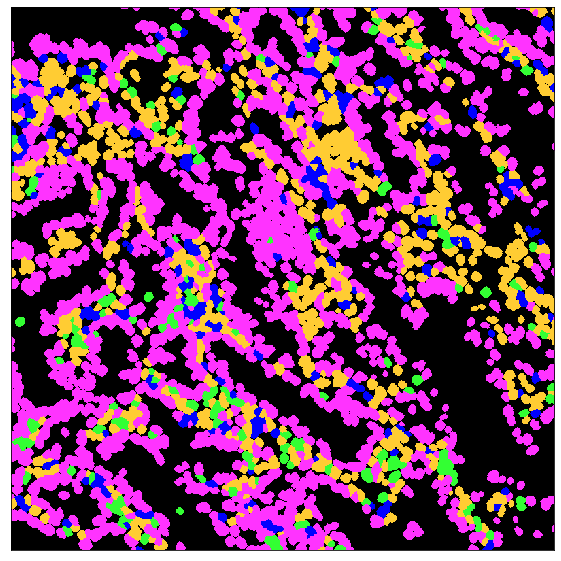

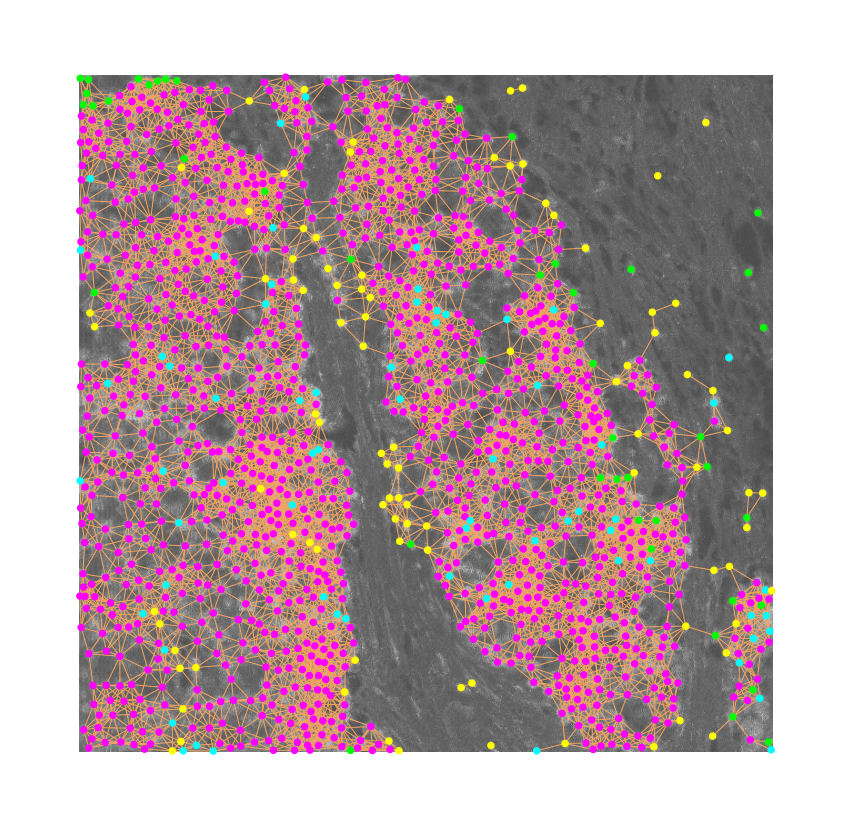

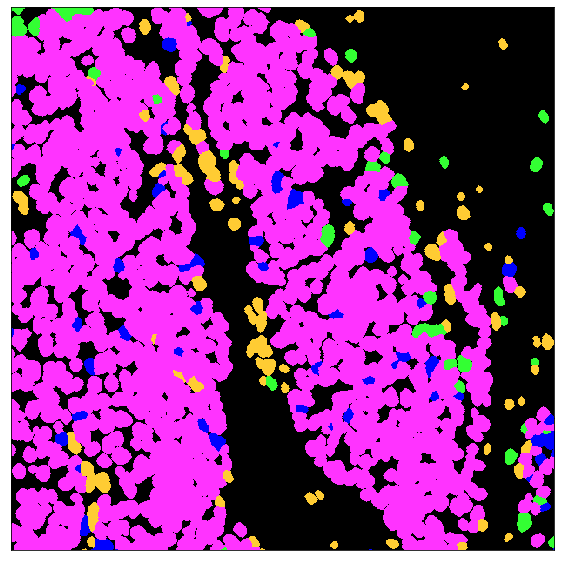

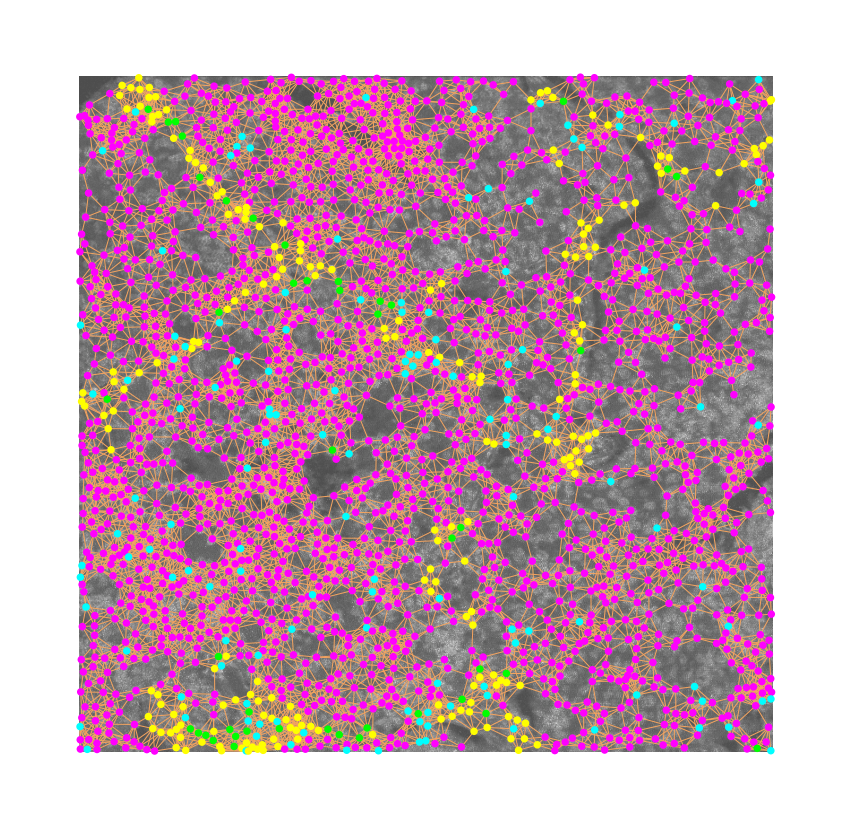

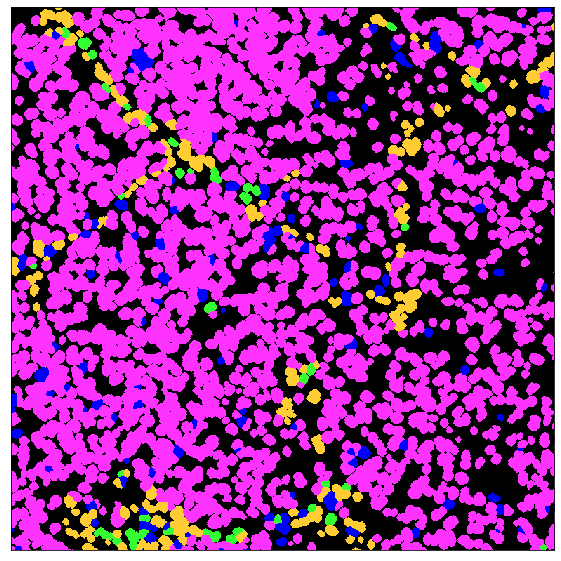

In [25]:
marker_list = [['ECadherin','PanKeratin'], ['CD68'],['CD8a'], ['Col1', 'SMA']]
labels = ['ECA+PanK', 'CD68', 'CD8', 'Col1+SMA']
rgb = np.array([[255,0,255], [0,255,0], [0,255,255], [255,255,0], [160,160,160]])
mycmap = ListedColormap(rgb/255)
rgb2 = np.array([[255,51,255], [51,255,51], [0,0,255], [255,204,51], [160,160,160]])
mycmap2 = ListedColormap(rgb2/255)
scores = defaultdict(list)
density = defaultdict(list)
scores_count = defaultdict(list)
show=True
n = 25


for dataset in datasets:
    # Read image and cell_mask
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    cell_mask = read_cell_mask(dataset)
    min_shape = min(cell_mask.shape[0], cell_mask.shape[1])
    min_shape = myround(min_shape, base=n)
    cell_mask = cell_mask[:min_shape, :min_shape]

    imgs_list = []
    #     p2, p98 = np.percentile(imgs, (20.0, 99.0))
    for markers in marker_list:
        temp = []
        for marker in markers:
            img = marker2img[marker]
            # if marker == 'CD8a':
            #     img = median(img, disk(1))
            p2, p98 = np.percentile(img, (0, 99.9))
            img = exposure.rescale_intensity(img, in_range=(p2, p98))
            temp.append(img[:min_shape, :min_shape])
        imgs_list.append(np.array(np.mean(temp, axis=(0))))

    # Grayscale backgroun image
    avg_img = np.array(np.mean(imgs, axis=(0)))[:min_shape, :min_shape]

    # Get cell neighbors analysis
    distances, neighbors, cell_labels, graph, X = get_distances(cell_mask)
    df = get_cell_expression_level_mean(imgs_list, labels, cell_mask)
    df['ECA+PanK'] = df['ECA+PanK'] * 0.6
    node_class, node_colors = get_cell_color(df, labels, rgb)

    node_class, _ = get_cell_color(df, labels, rgb)
    neighbor_class = get_nei_info(cell_labels, neighbors, node_class, distances)
    node_patch = get_node_patch(X, node_class, n)

    #Plot proximity map
    fig, ax = plt.subplots(figsize=(15,15))
    ax.axis('off')
    top, right = avg_img.shape
    ax.imshow(avg_img, cmap='gray', alpha=0.7, aspect='auto', extent=[0,right,0,top], origin='lower')
    plot_nn(X, graph, node_colors, ax)
    ax.invert_yaxis()

    #Plot cell mask
    img = replace_with_dict(cell_mask , node_class)
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(img, cmap=mycmap2, interpolation='None', vmin=0, vmax=5)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('black')
    
    unique, counts = np.unique(img[~np.isnan(img)], return_counts=True)
    scale = (imgs[0].shape[0] * imgs[1].shape[1])/1000000
    density['Tumor'].append(counts[0]/scale)
    density['Stroma'].append(counts[3]/scale)
    density['CD8+'].append(counts[2]/scale)
    density['CD68+'].append(counts[1]/scale)
    
     # Get Tumor and Stroma island 
    tumor = patch_count(0, node_class, node_patch, n, avg_img.shape)
    inegatif = patch_count(1, node_class, node_patch, n, avg_img.shape)
    ipositif = patch_count(2, node_class, node_patch, n, avg_img.shape)
    stroma = patch_count(3, node_class, node_patch, n, avg_img.shape)
    
    total = [patch_count(i, node_class, node_patch, n, avg_img.shape)  for i in range(5)]
    total = np.sum(total, axis=(0))
    P_tumor = np.divide(tumor, total, out=np.zeros_like(total), where=total!=0)
    P_ip = np.divide(ipositif, total, out=np.zeros_like(total), where=total!=0)
    P_in = np.divide(inegatif, total, out=np.zeros_like(total), where=total!=0)
    P_stroma = np.divide(stroma, total, out=np.zeros_like(total), where=total!=0)

    # IP to tumor
    ip_t_int = patch_count_neighbor(2, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_s_int = patch_count_neighbor(2, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_ip_int = patch_count_neighbor(2, 2, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_in_int = patch_count_neighbor(2, 1, neighbor_class, node_class, node_patch, n, avg_img.shape)
    ip_int_total = [patch_count_neighbor(2, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    ip_int_total = np.sum(ip_int_total, axis=(0))
    P_ip_t = np.divide(ip_t_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_s = np.divide(ip_s_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_ip = np.divide(ip_ip_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)
    P_ip_in = np.divide(ip_in_int, ip_int_total, out=np.zeros_like(ip_int_total), where=ip_int_total!=0)

    # IN to tumor
    in_t_int = patch_count_neighbor(1, 0, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_ip_int = patch_count_neighbor(1, 2, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_in_int = patch_count_neighbor(1, 1, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_s_int = patch_count_neighbor(1, 3, neighbor_class, node_class, node_patch, n, avg_img.shape)
    in_int_total = [patch_count_neighbor(1, i, neighbor_class, node_class, node_patch, n, avg_img.shape) for i in range(5)]
    in_int_total = np.sum(in_int_total, axis=(0))
    P_in_t = np.divide(in_t_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_s = np.divide(in_s_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_in = np.divide(in_in_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)
    P_in_ip = np.divide(in_ip_int, in_int_total, out=np.zeros_like(in_int_total), where=in_int_total!=0)


    scores['CD8-T'].append(round(np.mean(P_ip_t),4))
    scores['CD8-CD68'].append(round(np.mean(P_ip_in),4))
    scores['CD8-S'].append(round(np.mean(P_ip_s),4))
    scores['CD68-T'].append(round(np.mean(P_in_t),4))
    scores['CD68-CD8'].append(round(np.mean(P_in_ip),4))
    scores['CD68-S'].append(round(np.mean(P_in_s),4))

In [26]:
density_ch2 = density

# Merge two

In [27]:
df_old = pd.DataFrame(scores, index=datasets)
df_old.index = [index[-2:] for index in df_old.index]

In [28]:
df_old

,CD8-T,CD8-CD68,CD8-S,CD68-T,CD68-CD8,CD68-S
B1,0.0218,0.0015,0.0022,0.0383,0.0013,0.0132
B3,0.0519,0.0264,0.0314,0.0875,0.0193,0.1076
B5,0.0578,0.0122,0.0270,0.0944,0.0116,0.0302
C6,0.0931,0.1086,0.0662,0.1600,0.0880,0.0834
D7,0.0698,0.0877,0.0859,0.1155,0.0555,0.1501
D9,0.0399,0.0140,0.0253,0.0493,0.0119,0.0268
E1,0.1230,0.1446,0.1279,0.0868,0.1807,0.1318
B6,0.0682,0.0286,0.0526,0.0496,0.0275,0.0361
F3,0.0907,0.1823,0.1718,0.0621,0.1912,0.1777
F2,0.0588,0.0700,0.0632,0.1008,0.0632,0.0736


In [29]:
df_all = pd.concat([df_new, df_old], keys=['CH1', 'CH2'])
df_all.index = ['_'.join(ind) for ind in df_all.index.values]

In [30]:
from sklearn import preprocessing
scaler = preprocessing.MinMaxScaler()

In [31]:
values = scaler.fit_transform(df_all.values)

df_all = pd.DataFrame(values, columns=df_all.columns, index=df_all.index)*10

In [32]:
df_all.round(2).to_clipboard()

In [33]:
df_sorted = df_all.sort_values(['CD8-T'])

from sklearn.preprocessing import LabelEncoder

LE = LabelEncoder()
colors = LE.fit_transform(pd.qcut(df_sorted['CD8-T'], q=[0., 0.25, 0.75, 1.0]))

In [34]:
cd8_t_sort = pd.qcut(df_sorted['CD8-T'], q=[0., 0.25, 0.75, 1.0])

Text(0, 0.5, 'CD8-Tumor')

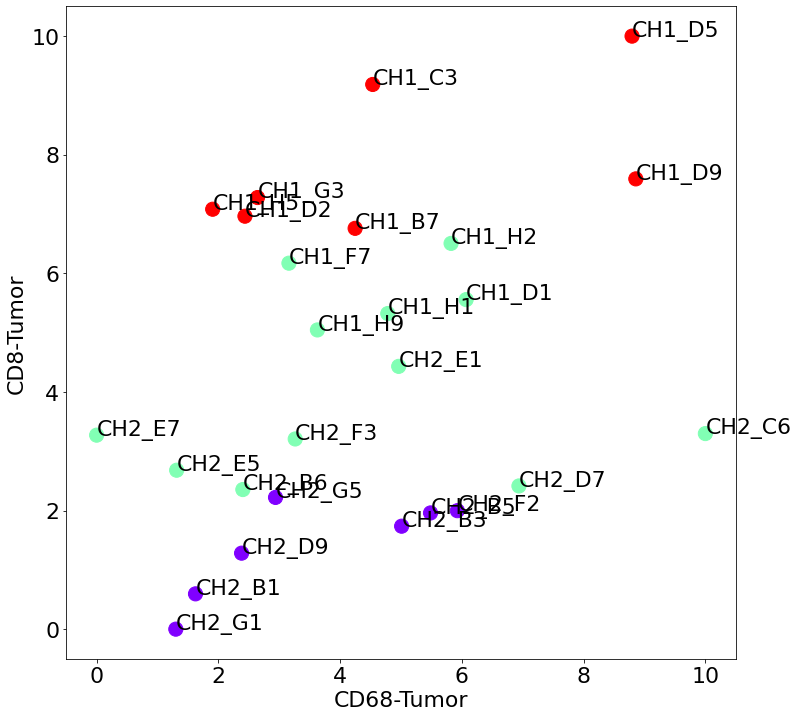

In [35]:
plt.rcParams.update({'font.size': 22})

x = df_sorted['CD68-T'].to_numpy()
y = df_sorted['CD8-T'].to_numpy()

fig, ax = plt.subplots(figsize=(12,12))
ax.scatter(x, y, s=200, c=colors, cmap='rainbow')
for i, txt in enumerate(df_sorted.index.tolist()):
    ax.annotate(txt, (x[i], y[i]))
    
ax.set_xlabel('CD68-Tumor')
ax.set_ylabel('CD8-Tumor')

In [36]:
df_sorted.reset_index(inplace=True)

In [37]:
import matplotlib 
cmap = matplotlib.cm.get_cmap('rainbow')
colors_bar = cmap(colors/np.max(colors))

[Text(0, 0, 'CH2_G1'),
 Text(1, 0, 'CH2_B1'),
 Text(2, 0, 'CH2_D9'),
 Text(3, 0, 'CH2_B3'),
 Text(4, 0, 'CH2_B5'),
 Text(5, 0, 'CH2_F2'),
 Text(6, 0, 'CH2_G5'),
 Text(7, 0, 'CH2_B6'),
 Text(8, 0, 'CH2_D7'),
 Text(9, 0, 'CH2_E5'),
 Text(10, 0, 'CH2_F3'),
 Text(11, 0, 'CH2_E7'),
 Text(12, 0, 'CH2_C6'),
 Text(13, 0, 'CH2_E1'),
 Text(14, 0, 'CH1_H9'),
 Text(15, 0, 'CH1_H1'),
 Text(16, 0, 'CH1_D1'),
 Text(17, 0, 'CH1_F7'),
 Text(18, 0, 'CH1_H2'),
 Text(19, 0, 'CH1_B7'),
 Text(20, 0, 'CH1_D2'),
 Text(21, 0, 'CH1_H5'),
 Text(22, 0, 'CH1_G3'),
 Text(23, 0, 'CH1_D9'),
 Text(24, 0, 'CH1_C3'),
 Text(25, 0, 'CH1_D5')]

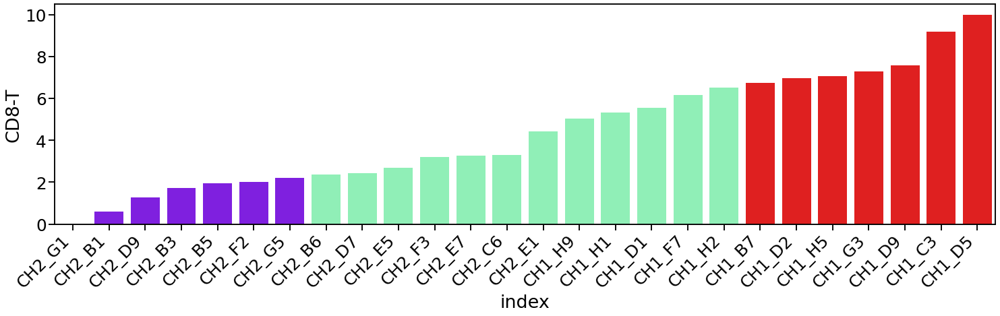

In [38]:
plt.rcParams.update({'font.size': 10})
sns.set_context('talk', font_scale=1.5)
fig, ax = plt.subplots(figsize=(25,6))
ax = sns.barplot(data=df_sorted, x='index', y='CD8-T', palette=colors_bar)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

In [290]:
df_new['Immune Status'] =  [
    'Suppressed', 'Inflamed', 'Inflamed', 
    'Inflamed', 'Inflamed', 'Suppressed', 
    'Inflamed', 'Inflamed', 'Cold', 
    'Suppressed', 'Inflamed', 'Suppressed'
]
df_old['Immune Status'] = [
    'Cold', 'Suppressed', 'Suppressed',
    'Suppressed', 'Suppressed', 'Cold', 
    'Inflamed', 'Cold', 'Suppressed', 
    'Suppressed', 'Cold', 'Cold',
    'Cold', 'Cold'
]
       
df_all = pd.concat([df_new, df_old], keys=['CH1', 'CH2'])
df_all.index = ['_'.join(ind) for ind in df_all.index.values]

In [291]:
df_all.sort_values(by=['CD8-T'])

,CD68-T,CD68-S,CD68-CD8,CD8-T,CD8-S,CD8-CD68,Immune Status
CH2_G1,0.0336,0.0758,0.0113,0.0061,0.0602,0.0121,Cold
CH2_B1,0.0383,0.0132,0.0013,0.0218,0.0022,0.0015,Cold
CH2_D9,0.0493,0.0268,0.0119,0.0399,0.0253,0.0140,Cold
CH2_B3,0.0875,0.1076,0.0193,0.0519,0.0314,0.0264,Suppressed
CH2_B5,0.0944,0.0302,0.0116,0.0578,0.0270,0.0122,Suppressed
CH2_F2,0.1008,0.0736,0.0632,0.0588,0.0632,0.0700,Suppressed
CH2_G5,0.0574,0.0453,0.0139,0.0647,0.0596,0.0117,Cold
CH2_B6,0.0496,0.0361,0.0275,0.0682,0.0526,0.0286,Cold
CH2_D7,0.1155,0.1501,0.0555,0.0698,0.0859,0.0877,Suppressed
CH2_E5,0.0338,0.0087,0.0028,0.0768,0.0073,0.0021,Cold


In [292]:
df_all = df_all.loc[['CH1_D1', 'CH1_C3', 'CH1_G3', 'CH1_F7', 
                     'CH2_C6', 'CH2_D7', 'CH2_F2', 'CH1_H9', 
                     'CH2_B1' ,'CH2_E5', 'CH2_E7', 'CH2_E7']]

In [293]:
df_all = pd.melt(df_all, id_vars=['Immune Status'], var_name='Interaction', value_name='Density')

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

CD68-CD8_Inflamed vs. CD68-CD8_Suppressed: t-test independent samples, P_val:8.472e-01 t=2.012e-01
CD8-T_Inflamed vs. CD8-T_Suppressed: t-test independent samples, P_val:1.015e-02 t=3.695e+00
CD8-S_Inflamed vs. CD8-S_Suppressed: t-test independent samples, P_val:5.593e-01 t=6.179e-01
CD8-CD68_Inflamed vs. CD8-CD68_Suppressed: t-test independent samples, P_val:3.106e-03 t=-4.766e+00
CD68-S_Suppressed vs. CD68-S_Cold: t-test independent samples, P_val:1.860e-03 t=5.283e+00
CD68-CD8_Suppressed vs. CD68-CD8_Cold: t-test independent samples, P_val:8.408e-05 t=9.365e+00
CD8-T_Suppressed vs. CD8-T_Cold: t-test independent samples, P_val:4.585e-01 t=7.920e-01
CD8-S_Suppressed vs. CD8-S_Cold: t-test independent samples, P_val:2.633e-03 t=4.929e+00
CD8-CD68_Suppressed vs. CD8-CD68_Cold: t-test independent samples, P_v

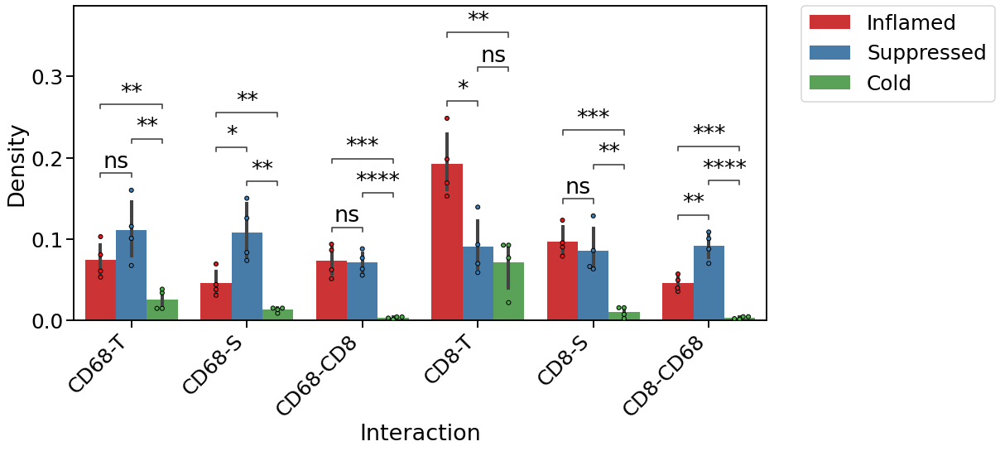

In [294]:
x = 'Interaction'
hue_plot_params = {
    'data':      df_all,
    'x':         x,
    'y':         'Density',
    # "order":     ['Tumor', 'CD8+', 'CD68+', 'Stroma'],
    "hue":       "Immune Status",
    "hue_order": ['Inflamed', 'Suppressed', 'Cold',],
    "palette":   "Set1"
}

# Plot
fig, ax = plt.subplots(figsize=(15, 7))
ax = sns.barplot(**hue_plot_params)
ax = sns.swarmplot(**hue_plot_params, dodge=True, edgecolor='k', linewidth=1.0)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[-3:], labels[-3:], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
ax.set_ylabel("Density")
ax.ticklabel_format(axis='y', style='sci')
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

# Anotation paris
pairs = [[(cell_type, 'Inflamed'), (cell_type, 'Cold')] for cell_type in df_all[x].unique()] 
pairs += [[(cell_type, 'Inflamed'), (cell_type, 'Suppressed')] for cell_type in df_all[x].unique()] 
pairs +=  [[(cell_type, 'Suppressed'), (cell_type, 'Cold')] for cell_type in df_all[x].unique()]

# Add annotations
annotator = Annotator(ax, pairs, **hue_plot_params)
annotator.configure(test='t-test_ind', verbose=True)
_, results = annotator.apply_and_annotate()


# Density plot

In [295]:
df_density_new

,Tumor,Stroma,CD8+,CD68+,Immune Status
B7,305575.555556,90977.777778,116562.666667,36834.666667,Suppressed
C3,331559.555556,121657.777778,197439.555556,45908.000000,Inflamed
D1,318996.444444,115423.111111,168171.555556,58828.888889,Inflamed
D2,221632.888889,205687.555556,124269.777778,45711.111111,Inflamed
D5,454287.555556,68356.000000,47493.777778,45306.222222,Inflamed
D9,249353.333333,227196.444444,95804.444444,53966.222222,Suppressed
F7,365891.111111,103400.888889,132750.666667,38475.111111,Inflamed
G3,274615.111111,173001.333333,141412.888889,41836.000000,Inflamed
H1,463510.666667,37166.666667,41975.111111,19755.555556,Cold
H2,205629.777778,109238.666667,89418.666667,80794.666667,Suppressed


In [296]:
df_density_old

,Tumor,Stroma,CD8+,CD68+,Immune Status
B1,534046.875000,75698.437500,4325.000000,15864.062500,Cold
B3,286782.812500,253129.687500,27526.562500,107507.812500,Suppressed
B5,519682.812500,88925.000000,32526.562500,47914.062500,Suppressed
C6,223584.375000,118423.437500,110353.125000,312929.687500,Suppressed
D7,271167.187500,191465.625000,63468.750000,283831.250000,Suppressed
D9,343242.187500,86915.625000,23698.437500,49710.937500,Cold
E1,196734.375000,226167.187500,221176.562500,165039.062500,Inflamed
B6,106473.437500,93348.437500,49534.375000,48740.625000,Cold
F3,193517.187500,229317.187500,226934.375000,229390.625000,Suppressed
F2,137789.062500,104476.562500,79279.687500,212157.812500,Suppressed


In [297]:
df_density_new = pd.DataFrame(density_ch1, index=datasets_new)
df_density_new = df_density_new
df_density_new['Immune Status'] =  [
    'Suppressed', 'Inflamed', 'Inflamed', 
    'Inflamed', 'Inflamed', 'Suppressed', 
    'Inflamed', 'Inflamed', 'Cold', 
    'Suppressed', 'Inflamed', 'Suppressed'
]
df_density_old = pd.DataFrame(density, index=datasets)
df_density_old['Immune Status'] = [
    'Cold', 'Suppressed', 'Suppressed',
    'Suppressed', 'Suppressed', 'Cold', 
    'Inflamed', 'Cold', 'Suppressed', 
    'Suppressed', 'Cold', 'Cold',
    'Cold', 'Cold'
]
       
df_density_old.index = [index[-2:] for index in df_density_old.index]

In [298]:
df_all = pd.concat([df_density_new , df_density_old], keys=['CH1', 'CH2'])
df_all.index = ['_'.join(ind) for ind in df_all.index.values]

In [299]:
df_all.sort_values(by=['CD8+'])

,Tumor,Stroma,CD8+,CD68+,Immune Status
CH2_B1,534046.875000,75698.437500,4325.000000,15864.062500,Cold
CH2_E5,390867.063492,25656.746032,14434.523810,12186.507937,Cold
CH2_G1,39090.625000,124743.750000,19068.750000,45734.375000,Cold
CH2_D9,343242.187500,86915.625000,23698.437500,49710.937500,Cold
CH2_E7,493256.369427,39382.165605,26609.872611,9382.165605,Cold
CH2_B3,286782.812500,253129.687500,27526.562500,107507.812500,Suppressed
CH2_B5,519682.812500,88925.000000,32526.562500,47914.062500,Suppressed
CH2_G5,316270.312500,145348.437500,40798.437500,33754.687500,Cold
CH1_H1,463510.666667,37166.666667,41975.111111,19755.555556,Cold
CH1_D5,454287.555556,68356.000000,47493.777778,45306.222222,Inflamed


In [300]:
df_all = df_all.loc[['CH1_D1', 'CH1_C3', 'CH1_G3', 'CH1_F7', 
                     'CH2_C6', 'CH2_D7', 'CH2_F2', 'CH1_H9', 
                     'CH2_B1' ,'CH2_E5', 'CH2_E7', 'CH2_E7']]

In [301]:
df_all = pd.melt(df_all, id_vars=['Immune Status'], var_name='Cell Type', value_name='Density')

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Stroma_Inflamed vs. Stroma_Suppressed: t-test independent samples, P_val:5.291e-01 t=-6.678e-01
CD68+_Inflamed vs. CD68+_Suppressed: t-test independent samples, P_val:5.894e-03 t=-4.168e+00
Stroma_Suppressed vs. Stroma_Cold: t-test independent samples, P_val:4.812e-03 t=4.352e+00
CD8+_Suppressed vs. CD8+_Cold: t-test independent samples, P_val:9.264e-04 t=6.046e+00
CD68+_Suppressed vs. CD68+_Cold: t-test independent samples, P_val:2.528e-03 t=4.970e+00
Tumor_Inflamed vs. Tumor_Suppressed: t-test independent samples, P_val:1.724e-02 t=3.261e+00
CD8+_Inflamed vs. CD8+_Suppressed: t-test independent samples, P_val:5.693e-03 t=4.199e+00
Tumor_Suppressed vs. Tumor_Cold: t-test independent samples, P_val:9.436e-04 t=-6.025e+00
Stroma_Inflamed vs. Stroma_Cold: t-test independent samples, P_val:4.326e-03 t=4.451e+00

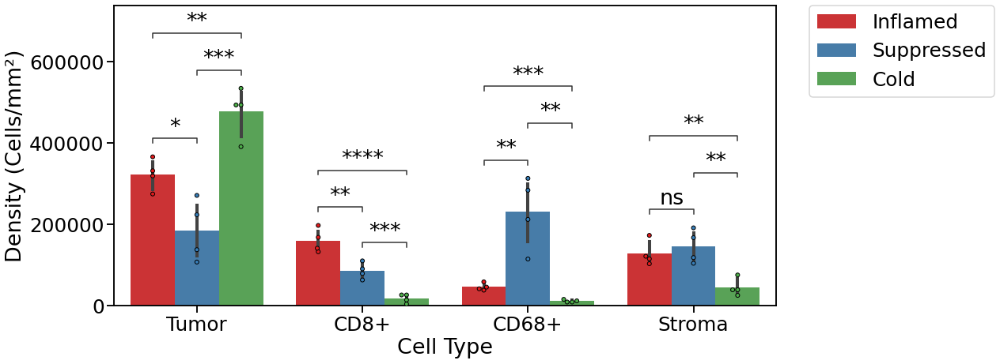

In [302]:
hue_plot_params = {
    'data':      df_all,
    'x':         'Cell Type',
    'y':         'Density',
    "order":     ['Tumor', 'CD8+', 'CD68+', 'Stroma'],
    "hue":       "Immune Status",
    "hue_order": ['Inflamed', 'Suppressed', 'Cold',],
    "palette":   "Set1"
}

# Plot
fig, ax = plt.subplots(figsize=(15, 7))
ax = sns.barplot(**hue_plot_params)
ax = sns.swarmplot(**hue_plot_params, dodge=True, edgecolor='k', linewidth=1.0)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[-3:], labels[-3:], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
# ax.legend(handles[-3:], labels[-3:])

ax.set_ylabel("Density (Cells/mm\u00b2)")
ax.ticklabel_format(axis='y', style='sci')

# Anotation paris
pairs = [[(cell_type, 'Inflamed'), (cell_type, 'Cold')] for cell_type in df_all['Cell Type'].unique()] 
pairs += [[(cell_type, 'Inflamed'), (cell_type, 'Suppressed')] for cell_type in df_all['Cell Type'].unique()] 
pairs +=  [[(cell_type, 'Suppressed'), (cell_type, 'Cold')] for cell_type in df_all['Cell Type'].unique()]

# Add annotations
annotator = Annotator(ax, pairs, **hue_plot_params)
annotator.configure(test='t-test_ind', verbose=True)
_, results = annotator.apply_and_annotate()
